In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as sch
import mpl_toolkits.mplot3d.axes3d as p3
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn import metrics, mixture, cluster, datasets
from sklearn.mixture import GaussianMixture
from sklearn.datasets import make_moons
from sklearn.cluster import AgglomerativeClustering, KMeans, DBSCAN
from sklearn.neighbors import kneighbors_graph
from itertools import cycle, islice
import time
from itertools import pairwise
from math import ceil

In [3]:
import warnings
warnings.filterwarnings('ignore')
sns.set_theme(context='notebook', palette='viridis')

In [4]:
pd.set_option('display.max_columns', 500)

In [5]:
df = pd.read_csv('6M-0K-99K.users.dataset.public.csv')
display(df.head(), df.describe(), df.info(), df.isnull().sum(), df.nunique())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98913 entries, 0 to 98912
Data columns (total 24 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   identifierHash       98913 non-null  int64  
 1   type                 98913 non-null  object 
 2   country              98913 non-null  object 
 3   language             98913 non-null  object 
 4   socialNbFollowers    98913 non-null  int64  
 5   socialNbFollows      98913 non-null  int64  
 6   socialProductsLiked  98913 non-null  int64  
 7   productsListed       98913 non-null  int64  
 8   productsSold         98913 non-null  int64  
 9   productsPassRate     98913 non-null  float64
 10  productsWished       98913 non-null  int64  
 11  productsBought       98913 non-null  int64  
 12  gender               98913 non-null  object 
 13  civilityGenderId     98913 non-null  int64  
 14  civilityTitle        98913 non-null  object 
 15  hasAnyApp            98913 non-null 

,identifierHash,type,country,language,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,civilityTitle,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,countryCode
0,-1097895247965112460,user,Royaume-Uni,en,147,10,77,26,174,74.0,104,1,M,1,mr,True,False,True,True,11,3196,106.53,8.88,gb
1,2347567364561867620,user,Monaco,en,167,8,2,19,170,99.0,0,0,F,2,mrs,True,False,True,True,12,3204,106.80,8.90,mc
2,6870940546848049750,user,France,fr,137,13,60,33,163,94.0,10,3,F,2,mrs,True,False,True,False,11,3203,106.77,8.90,fr
3,-4640272621319568052,user,Etats-Unis,en,131,10,14,122,152,92.0,7,0,F,2,mrs,True,False,True,False,12,3198,106.60,8.88,us
4,-5175830994878542658,user,Etats-Unis,en,167,8,0,25,125,100.0,0,0,F,2,mrs,False,False,False,True,22,2854,95.13,7.93,us


,identifierHash,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,civilityGenderId,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears
count,9.891300e+04,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000
mean,-6.692039e+15,3.432269,8.425677,4.420743,0.093304,0.121592,0.812303,1.562595,0.171929,1.773993,581.291236,3063.771870,102.125583,8.510424
std,5.330807e+18,3.882383,52.839572,181.030569,2.050144,2.126895,8.500205,25.192793,2.332266,0.428679,208.855888,168.298621,5.609735,0.467863
min,-9.223101e+18,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,11.000000,2852.000000,95.070000,7.920000
25%,-4.622895e+18,3.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,572.000000,2857.000000,95.230000,7.940000
50%,-1.337989e+15,3.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,694.000000,3196.000000,106.530000,8.880000
75%,4.616388e+18,3.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,702.000000,3201.000000,106.700000,8.890000
max,9.223331e+18,744.000000,13764.000000,51671.000000,244.000000,174.000000,100.000000,2635.000000,405.000000,3.000000,709.000000,3205.000000,106.830000,8.900000


None

identifierHash         0
type                   0
country                0
language               0
socialNbFollowers      0
socialNbFollows        0
socialProductsLiked    0
productsListed         0
productsSold           0
productsPassRate       0
productsWished         0
productsBought         0
gender                 0
civilityGenderId       0
civilityTitle          0
hasAnyApp              0
hasAndroidApp          0
hasIosApp              0
hasProfilePicture      0
daysSinceLastLogin     0
seniority              0
seniorityAsMonths      0
seniorityAsYears       0
countryCode            0
dtype: int64

identifierHash         98913
type                       1
country                  200
language                   5
socialNbFollowers         90
socialNbFollows           85
socialProductsLiked      420
productsListed            65
productsSold              75
productsPassRate          72
productsWished           279
productsBought            70
gender                     2
civilityGenderId           3
civilityTitle              3
hasAnyApp                  2
hasAndroidApp              2
hasIosApp                  2
hasProfilePicture          2
daysSinceLastLogin       699
seniority                 19
seniorityAsMonths         19
seniorityAsYears           6
countryCode              199
dtype: int64

In [6]:
df.shape

(98913, 24)

In [7]:
df.columns

Index(['identifierHash', 'type', 'country', 'language', 'socialNbFollowers',
       'socialNbFollows', 'socialProductsLiked', 'productsListed',
       'productsSold', 'productsPassRate', 'productsWished', 'productsBought',
       'gender', 'civilityGenderId', 'civilityTitle', 'hasAnyApp',
       'hasAndroidApp', 'hasIosApp', 'hasProfilePicture', 'daysSinceLastLogin',
       'seniority', 'seniorityAsMonths', 'seniorityAsYears', 'countryCode'],
      dtype='object')

In [8]:
df.drop(['identifierHash'], axis=1, inplace=True)

In [9]:
# check for duplicates
df.duplicated().sum()

49153

In [10]:
df.drop_duplicates(inplace=True)

In [11]:
df.shape

(49760, 23)

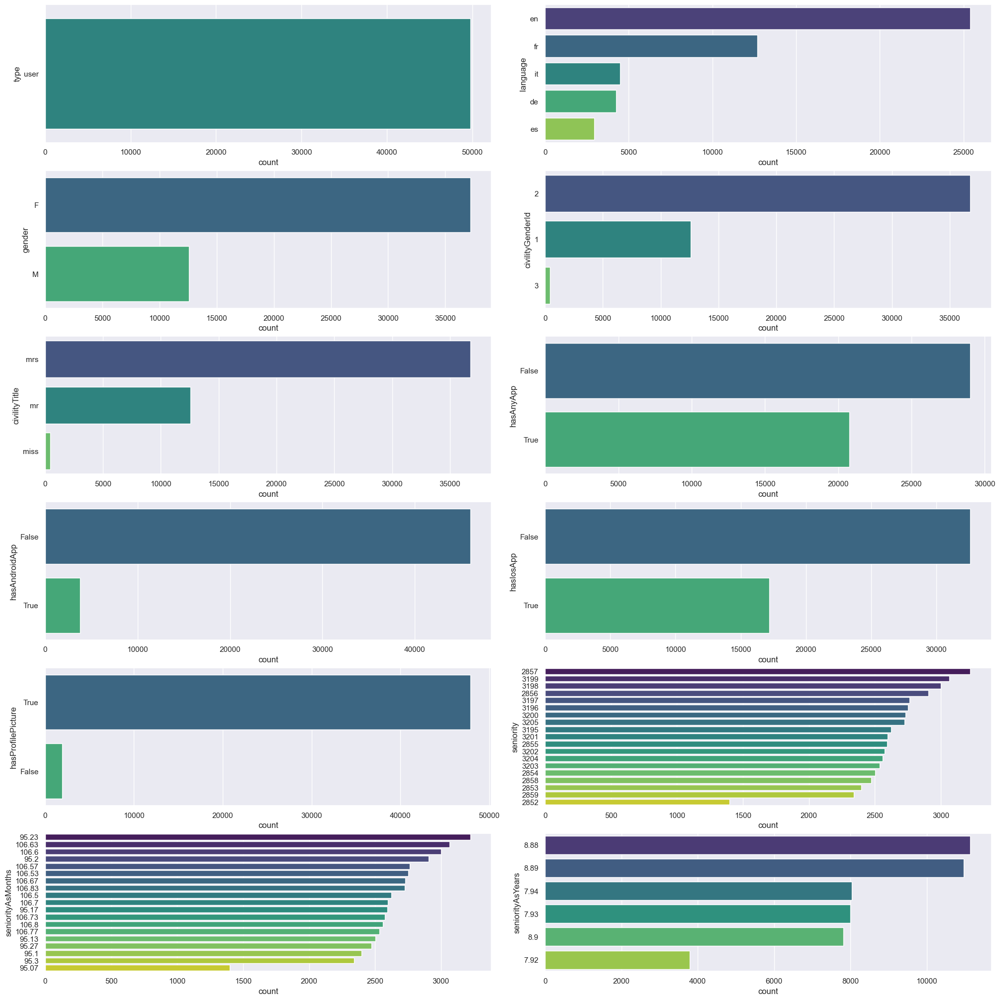

In [12]:
fig, axs = plt.subplots(6, 2, figsize=(20, 20), constrained_layout=True)
categorical = ['type', 'language', 'gender',
               'civilityGenderId', 'civilityTitle', 'hasAnyApp', 'hasAndroidApp',
               'hasIosApp', 'hasProfilePicture', 'seniority',
               'seniorityAsMonths', 'seniorityAsYears', ]
for i, f in enumerate(categorical):
    sns.countplot(y=f, data=df,
                  ax=axs[i//2][i % 2],
                  order=df[f].value_counts().index, palette='viridis')

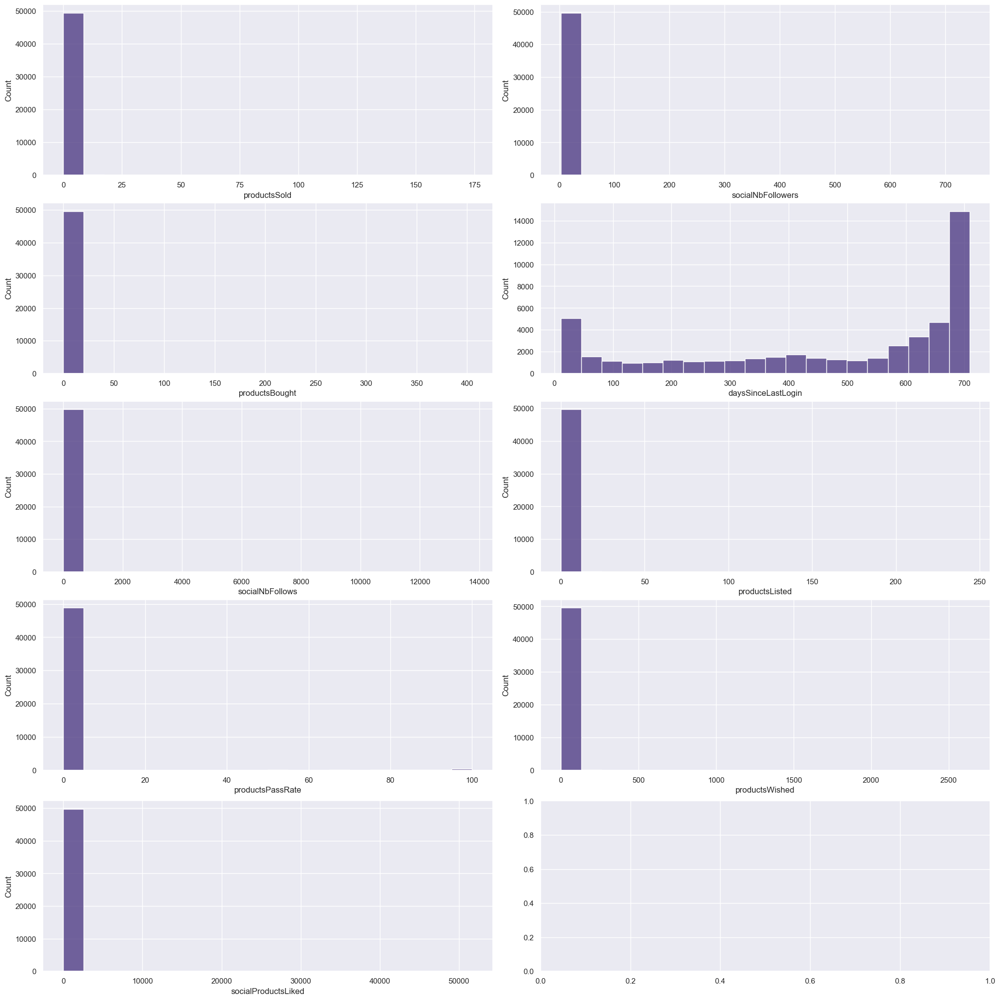

In [13]:
numerical = set(df.columns)-set(categorical)-{'countryCode', 'country'}
fig, axs = plt.subplots(len(numerical)//2+1, 2,
                        figsize=(20, 20), constrained_layout=True)

for i, f in enumerate(numerical):
    sns.histplot(x=f, data=df,
                 ax=axs[i//2][i % 2], bins=20,
                 palette=sns.color_palette("viridis", 2))

plt.show()

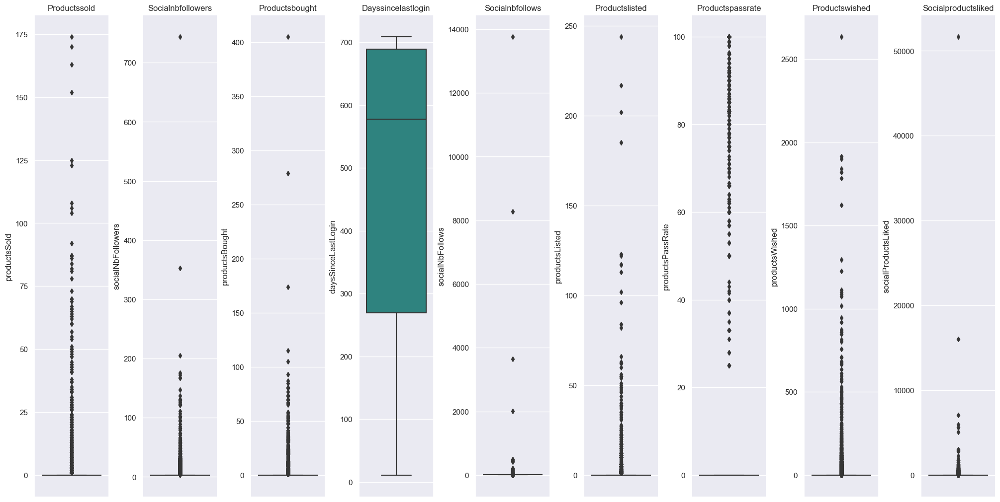

In [14]:
fig, axs = plt.subplots(1, 9,
                        figsize=(20, 10), constrained_layout=True)
for i, f in enumerate(numerical):
    sns.boxplot(y=f,  data=df,  ax=axs[i],
                palette="viridis")
    axs[i].set_title(f.capitalize())


plt.show()

In [15]:
numerical

{'daysSinceLastLogin',
 'productsBought',
 'productsListed',
 'productsPassRate',
 'productsSold',
 'productsWished',
 'socialNbFollowers',
 'socialNbFollows',
 'socialProductsLiked'}

In [16]:
df_discretization = df.copy()

In [17]:
df[df['socialNbFollows'] <= 8].shape

(45936, 23)

In [18]:
df['socialNbFollows'] = df['socialNbFollows'].apply(
    lambda x: 1 if x > 8 else 0)

In [19]:
df[df['socialProductsLiked'] == 0].shape

(34614, 23)

In [20]:
df['socialProductsLiked'] = df['socialProductsLiked'].apply(
    lambda x: 1 if x > 0 else 0)

In [21]:
df[df['productsSold'] == 0].shape

(47724, 23)

In [22]:
df['productsSold'] = df['productsSold'].apply(lambda x: 1 if x > 0 else 0)

In [23]:
df[df['productsWished'] == 0].shape

(40753, 23)

In [24]:
df['productsWished'] = df['productsWished'].apply(lambda x: 1 if x > 0 else 0)

In [25]:
df[df['productsPassRate'] == 0].shape

(48826, 23)

In [26]:
df['productsPassRate'] = df['productsPassRate'].apply(
    lambda x: 1 if x > 0 else 0)

In [27]:
df[df['socialNbFollowers'] == 3].shape

(39059, 23)

In [28]:
df['socialNbFollowers'] = df['socialNbFollowers'].apply(
    lambda x: 1 if x > 3 else 0)

In [29]:
df[df['productsListed'] == 0].shape

(48036, 23)

In [30]:
df['productsListed'] = df['productsListed'].apply(lambda x: 1 if x > 0 else 0)

In [31]:
df[df['productsBought'] == 0].shape

(44428, 23)

In [32]:
df['productsBought'] = df['productsBought'].apply(lambda x: 1 if x > 0 else 0)

In [33]:
df[df['daysSinceLastLogin'] > 350].shape

(34337, 23)

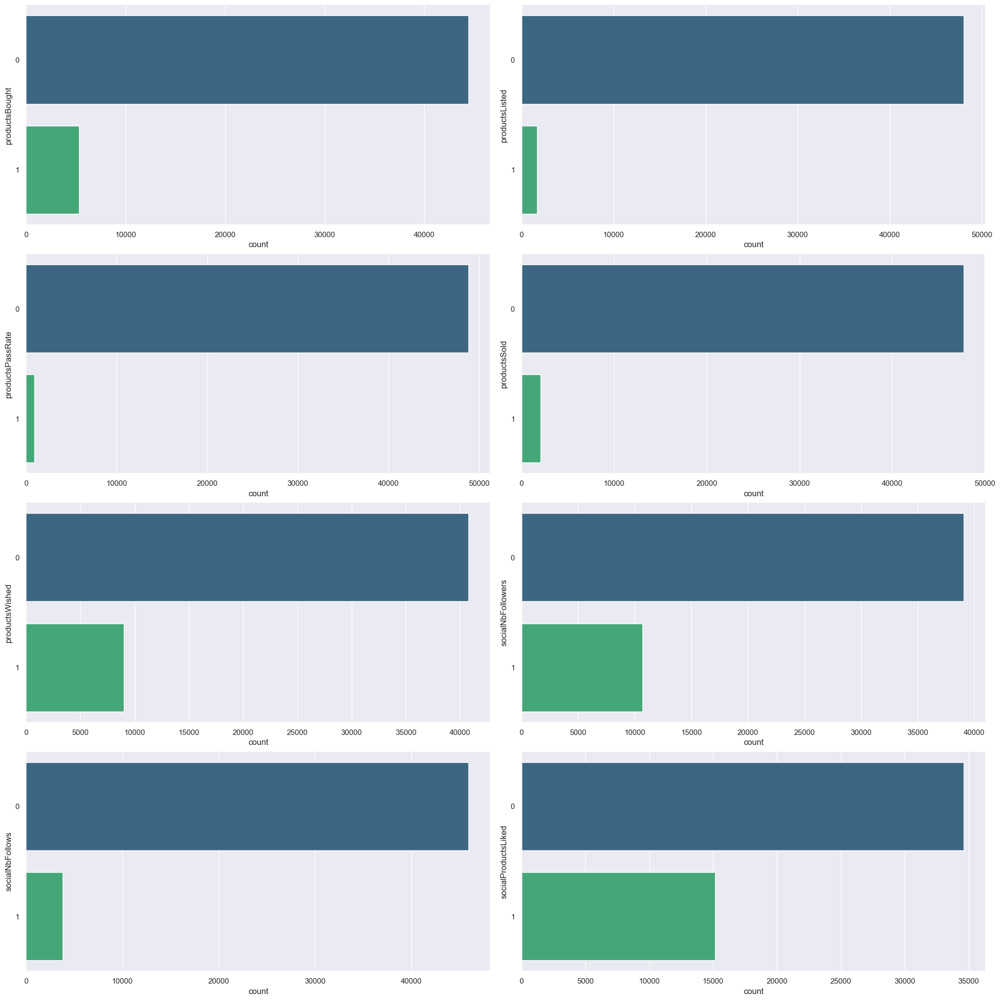

In [34]:
fig, axs = plt.subplots(4, 2, figsize=(20, 20), constrained_layout=True)
cols = ['productsBought', 'productsListed', 'productsPassRate',
        'productsSold', 'productsWished', 'socialNbFollowers', 'socialNbFollows', 'socialProductsLiked']
for i, f in enumerate(cols):
    sns.countplot(y=f, data=df,
                  ax=axs[i//2][i % 2],
                  order=df[f].value_counts().index, palette='viridis')

In [35]:
df.head()

,type,country,language,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,civilityTitle,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,countryCode
0,user,Royaume-Uni,en,1,1,1,1,1,1,1,1,M,1,mr,True,False,True,True,11,3196,106.53,8.88,gb
1,user,Monaco,en,1,0,1,1,1,1,0,0,F,2,mrs,True,False,True,True,12,3204,106.80,8.90,mc
2,user,France,fr,1,1,1,1,1,1,1,1,F,2,mrs,True,False,True,False,11,3203,106.77,8.90,fr
3,user,Etats-Unis,en,1,1,1,1,1,1,1,0,F,2,mrs,True,False,True,False,12,3198,106.60,8.88,us
4,user,Etats-Unis,en,1,0,0,1,1,1,0,0,F,2,mrs,False,False,False,True,22,2854,95.13,7.93,us


In [36]:
df.drop(['type'], axis=1, inplace=True)

In [37]:
df.head()

,country,language,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,civilityTitle,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,countryCode
0,Royaume-Uni,en,1,1,1,1,1,1,1,1,M,1,mr,True,False,True,True,11,3196,106.53,8.88,gb
1,Monaco,en,1,0,1,1,1,1,0,0,F,2,mrs,True,False,True,True,12,3204,106.80,8.90,mc
2,France,fr,1,1,1,1,1,1,1,1,F,2,mrs,True,False,True,False,11,3203,106.77,8.90,fr
3,Etats-Unis,en,1,1,1,1,1,1,1,0,F,2,mrs,True,False,True,False,12,3198,106.60,8.88,us
4,Etats-Unis,en,1,0,0,1,1,1,0,0,F,2,mrs,False,False,False,True,22,2854,95.13,7.93,us


In [38]:
# encode categorical
df["gender"] = df["gender"].map({'M': 0, 'F': 1})

In [39]:
# country_count = dict(df['countryCode'].value_counts())
# df['countryCode'] = df['countryCode'].map(country_count)

In [40]:
continents = {
    'Africa': ['eg', 'ma', 'ga', 'er', 'tn', 'dz', 'na', 'ci', 'gn', 'za', 'bj', 'zw', 'bf', 'mg', 'dj', 'sn', 'rw', 'ml', 'ne', 'ug', 'tg', 'tz', 'cf', 'bw', 'td', 'gm', 'mu', 'zm', 'ly', 'sz'],
    'Asia': ['tw', 'cy', 'sg', 'cn', 'jp', 'kz', 'my', 'bn', 'vn', 'ae', 'bh', 'mo', 'sa', 'lb', 'kh', 'in', 'kr', 'la', 'tr', 'mm', 'af', 'ph', 'am', 'mn', 'qa', 'id', 'th', 'ge', 'jo', 'kw', 'az', 'il', 'pk', 'lk', 'tj', 'om', 'bd', 'ir', 'sy', 'np', 'mv', 'iq', 'kp', 'kg', 'uz'],
    'Europe': ['gb', 'mc', 'fr', 'de', 'se', 'it', 'es', 'hr', 'lv', 'bg', 'lu', 'ro', 'nl', 'sk', 'at', 'be', 'ch', 'pl', 'gr', 'pt', 'ru', 'fi', 'si', 'dk', 'rs', 'ie', 'ua', 'lt', 'ee', 'is', 'hu', 'no', 'cz', 'al', 'md', 'mt', 'ba', 'by', 'li', 'ad', 'mk'],
    'North America': ['us', 'ca', 'bs', 'hn', 'mx', 'pr', 'ag', 'vg', 'bm', 'cr', 'do', 'bb', 'pa', 'tt', 'sv', 'ky', 'cu', 'gt', 'ai', 'tc', 'jm', 'bz', 'vc', 'gd', 'lc', 'ni', 'vi', 'ht', 'dm', 'kn'],
    'Oceania': ['au', 'ki', 'nz', 'vu', 'fj', 'pw', 'ws'],
    'South America': ['br', 'py', 'co', 'cl', 'ec', 'ar', 've', 'pe', 'gy', 'bo', 'uy', 'sr']
}

In [41]:
continents_inverse = {v: k for k, values in continents.items() for v in values}

In [42]:
df['continent'] = df['countryCode'].map(continents_inverse)

In [43]:
df.drop(['country'], axis=1, inplace=True)
df = pd.get_dummies(df, columns=['continent'])
df.head()

,language,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,civilityTitle,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,countryCode,continent_Africa,continent_Asia,continent_Europe,continent_North America,continent_Oceania,continent_South America
0,en,1,1,1,1,1,1,1,1,0,1,mr,True,False,True,True,11,3196,106.53,8.88,gb,False,False,True,False,False,False
1,en,1,0,1,1,1,1,0,0,1,2,mrs,True,False,True,True,12,3204,106.80,8.90,mc,False,False,True,False,False,False
2,fr,1,1,1,1,1,1,1,1,1,2,mrs,True,False,True,False,11,3203,106.77,8.90,fr,False,False,True,False,False,False
3,en,1,1,1,1,1,1,1,0,1,2,mrs,True,False,True,False,12,3198,106.60,8.88,us,False,False,False,True,False,False
4,en,1,0,0,1,1,1,0,0,1,2,mrs,False,False,False,True,22,2854,95.13,7.93,us,False,False,False,True,False,False


In [44]:
df = pd.get_dummies(df, columns=['language', 'civilityTitle'])

In [45]:
df_with_country_codes = df.copy()
df.drop(['countryCode'], axis=1, inplace=True)
df.head()

,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,continent_Africa,continent_Asia,continent_Europe,continent_North America,continent_Oceania,continent_South America,language_de,language_en,language_es,language_fr,language_it,civilityTitle_miss,civilityTitle_mr,civilityTitle_mrs
0,1,1,1,1,1,1,1,1,0,1,True,False,True,True,11,3196,106.53,8.88,False,False,True,False,False,False,False,True,False,False,False,False,True,False
1,1,0,1,1,1,1,0,0,1,2,True,False,True,True,12,3204,106.80,8.90,False,False,True,False,False,False,False,True,False,False,False,False,False,True
2,1,1,1,1,1,1,1,1,1,2,True,False,True,False,11,3203,106.77,8.90,False,False,True,False,False,False,False,False,False,True,False,False,False,True
3,1,1,1,1,1,1,1,0,1,2,True,False,True,False,12,3198,106.60,8.88,False,False,False,True,False,False,False,True,False,False,False,False,False,True
4,1,0,0,1,1,1,0,0,1,2,False,False,False,True,22,2854,95.13,7.93,False,False,False,True,False,False,False,True,False,False,False,False,False,True


<Axes: >

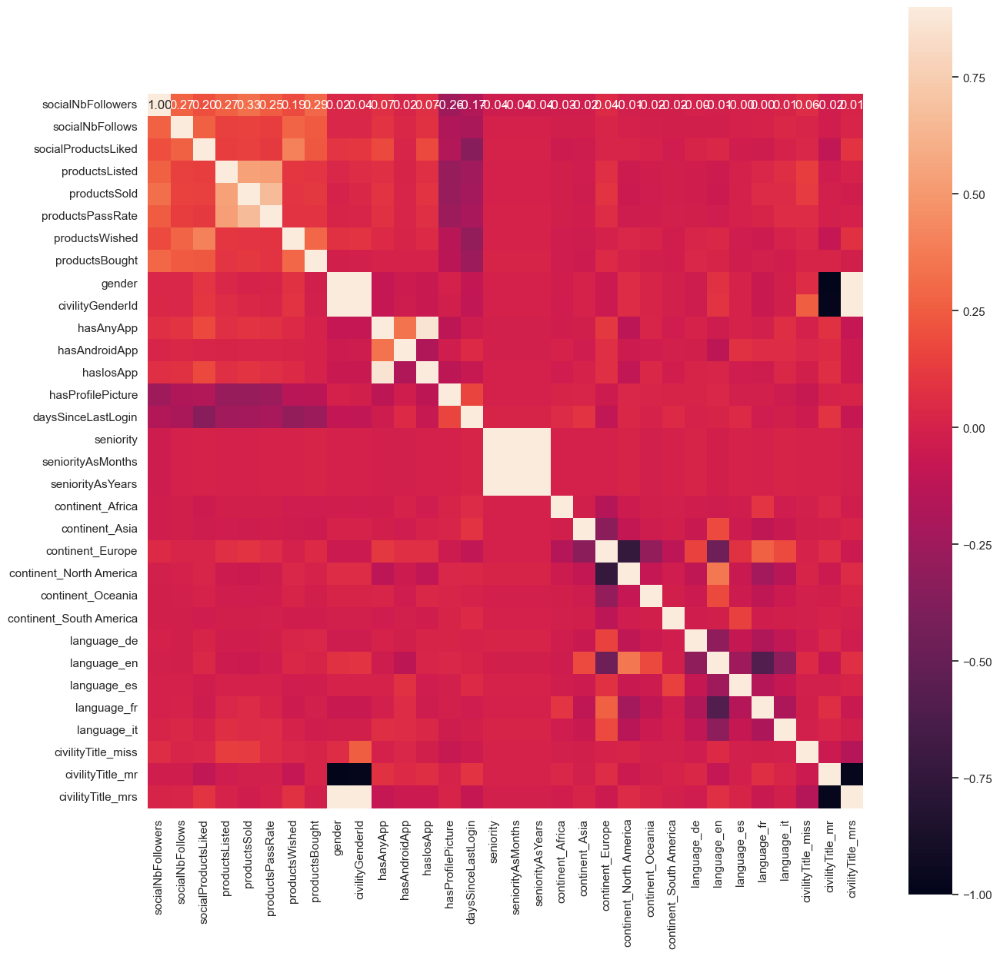

In [46]:
corr_matrix = df.corr()
plt.figure(figsize=(15, 15))
sns.heatmap(corr_matrix,  vmax=.9, square=True,
            annot=True, fmt='.2f')

In [47]:
# drop highly correlated features
df.drop(['civilityTitle_miss', 'civilityTitle_mr', 'civilityTitle_mrs', 'civilityGenderId',
         'seniorityAsMonths', 'seniorityAsYears'], axis=1, inplace=True)

<Axes: >

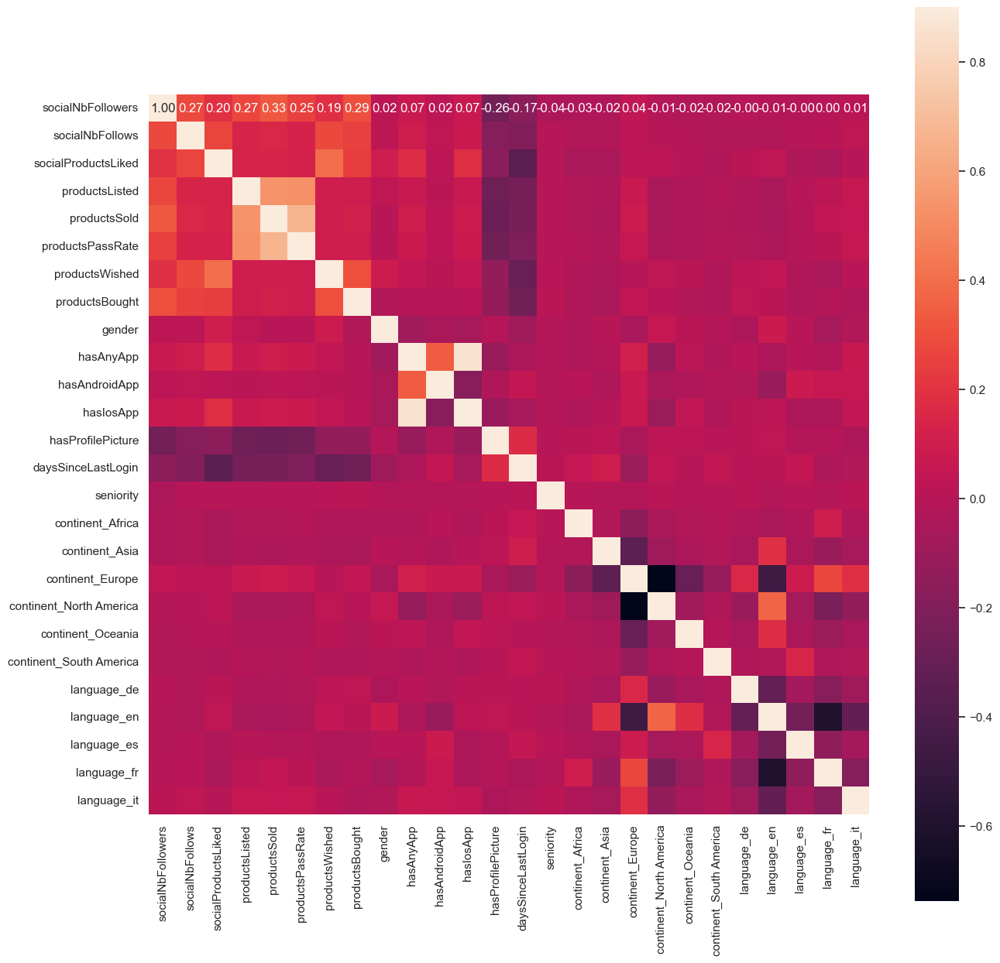

In [48]:
corr_matrix = df.corr()
plt.figure(figsize=(15, 15))
sns.heatmap(corr_matrix,  vmax=.9, square=True,
            annot=True, fmt='.2f')

In [49]:
scaler = MinMaxScaler((-1, 1))
df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)

df.describe()

,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,continent_Africa,continent_Asia,continent_Europe,continent_North America,continent_Oceania,continent_South America,language_de,language_en,language_es,language_fr,language_it
count,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000
mean,-0.569895,-0.846302,-0.391238,-0.930707,-0.918167,-0.962460,-0.637982,-0.785691,0.494695,-0.165555,-0.848834,-0.309807,0.924156,0.306102,0.193923,-0.981672,-0.917685,0.450844,-0.658320,-0.935088,-0.989349,-0.828859,0.020740,-0.881551,-0.489952,-0.820378
std,0.821725,0.532708,0.920299,0.365768,0.396197,0.271427,0.770059,0.618625,0.869076,0.986211,0.528664,0.950809,0.382019,0.698404,0.954915,0.190580,0.397313,0.892612,0.752746,0.354418,0.145565,0.559464,0.999795,0.472093,0.871758,0.571828
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,-0.260745,-0.971671,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
50%,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,1.000000,0.624642,0.949008,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000
75%,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,1.000000,-1.000000,1.000000,1.000000,0.942693,0.977337,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,-1.000000,1.000000,-1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [50]:
# from sklearn.neighbors import LocalOutlierFactor

# clf = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
# y_pred = clf.fit_predict(df)
# df = df[y_pred == 1]

# df.shape

In [51]:
from sklearn.ensemble import IsolationForest

clf = IsolationForest(contamination=0.03)
y_pred = clf.fit_predict(df)
df = df[y_pred == 1]

df.shape

(48267, 26)

In [52]:
df.head()

,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,continent_Africa,continent_Asia,continent_Europe,continent_North America,continent_Oceania,continent_South America,language_de,language_en,language_es,language_fr,language_it
4,1.0,-1.0,-1.0,1.0,1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-0.968481,-0.988669,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0
11,1.0,-1.0,-1.0,-1.0,1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-0.836676,-0.983003,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0
27,1.0,-1.0,-1.0,1.0,1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.000000,-0.977337,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0
34,1.0,-1.0,-1.0,1.0,1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-0.785100,1.000000,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0
35,1.0,-1.0,-1.0,1.0,1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-0.965616,0.988669,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0


In [53]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px


def plot_3d(X_pca, labels, title='3D PCA Cluster Plot'):
    fig = px.scatter_3d(x=X_pca[:, 0], y=X_pca[:, 1], z=X_pca[:, 2], color=labels,
                        labels={'x': 'PCA 0',
                                'y': 'PCA 1', 'z': 'PCA 2'},
                        title=title)
    fig.update_traces(marker=dict(size=3))
    fig.show()

In [54]:
def plot_2d(X_pca, clusters):
    plt.figure(figsize=(20, 5))
    plots_components = [(0, 1), (0, 2), (0, 3), (0, 4)]

    for i, (x, y) in enumerate(plots_components):
        plt.subplot(1, 4, i+1)
        plt.scatter(X_pca[:, x], X_pca[:, y], c=clusters,
                    cmap='viridis', s=50)
        plt.title(f'Original Data with True Clusters {x} vs {y}')
        plt.xlabel(f'Principal Component {x}')
        plt.ylabel(f'Principal Component {y}')
    plt.show()

In [55]:
def plot_feature_importance(df, clusters, centroids=None):
    if centroids is None:
        centroids = df.groupby(clusters).mean()

    feature_importance = centroids.std(axis=0)
    plt.figure(figsize=(10, 5))
    plt.bar(df.columns, feature_importance)
    plt.xticks(rotation=90)
    plt.title('Feature importance based on centroids')
    plt.show()

    return feature_importance

In [56]:
def analyze_features(df, feature_importance, clusters, num_clusters, thershold=0.25):
    important_columns = df.columns[feature_importance > thershold]
    cluster_data = np.array(
        [df[clusters == i][important_columns].mean(axis=0) for i in range(num_clusters)])
    cluster_data = pd.DataFrame(
        cluster_data.T, columns=range(num_clusters), index=important_columns)

    return cluster_data

2 3 4 5 6 7 8 9 10 11 

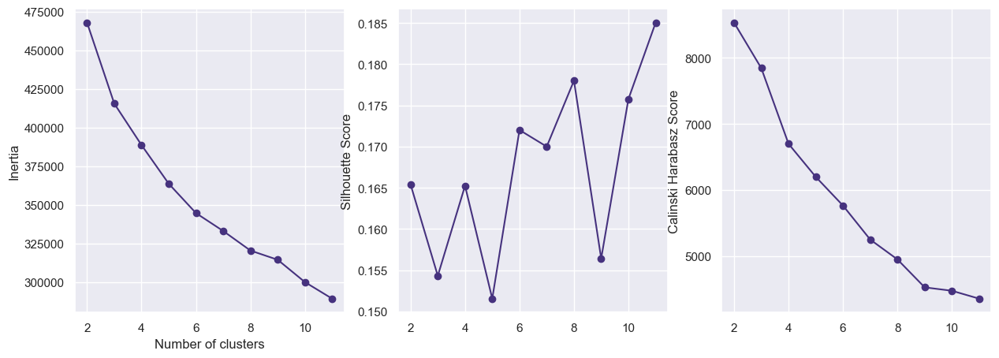

In [103]:
k_range = range(2, 12)
inertia = []
silhouette = []
calinski = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df)
    inertia.append(kmeans.inertia_)
    silhouette.append(metrics.silhouette_score(
        df, kmeans.labels_, sample_size=10000))
    calinski.append(metrics.calinski_harabasz_score(df, kmeans.labels_))
    print(k, end=' ')

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(k_range, inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.subplot(1, 3, 2)
plt.plot(k_range, silhouette, marker='o')
plt.ylabel('Silhouette Score')
plt.subplot(1, 3, 3)
plt.plot(k_range, calinski, marker='o')
plt.ylabel('Calinski Harabasz Score')
plt.show()

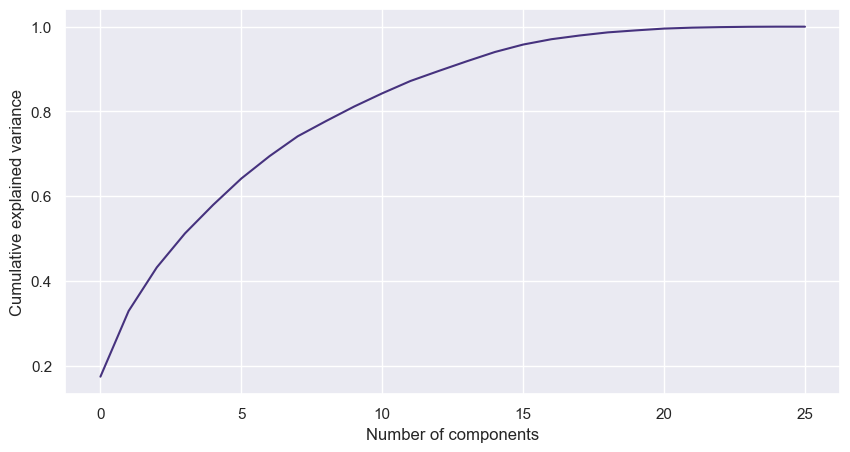

In [104]:
# apply pca
from sklearn.decomposition import PCA
pca = PCA()
pca.fit(df)
data_pca = pca.transform(df)

# plot pca
plt.figure(figsize=(10, 5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.show()

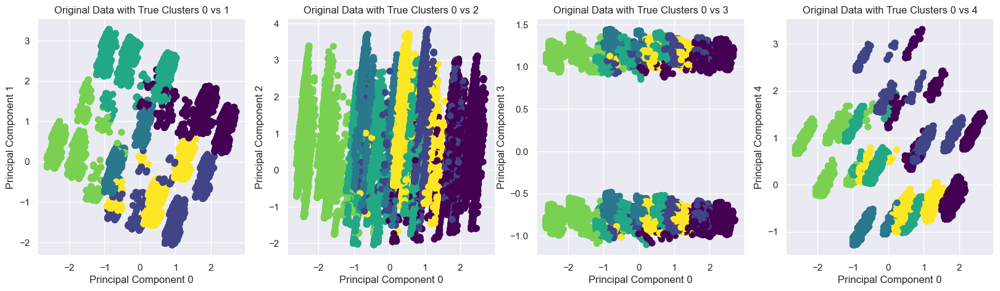

In [105]:
pca = PCA(n_components=5)
X_pca = pca.fit_transform(df)

# Apply KMeans clustering
NUM_CLUSTERS = 6
kmeans = KMeans(n_clusters=NUM_CLUSTERS, random_state=42)
clusters = kmeans.fit_predict(df)

plot_2d(X_pca, clusters)
plot_3d(X_pca, clusters)

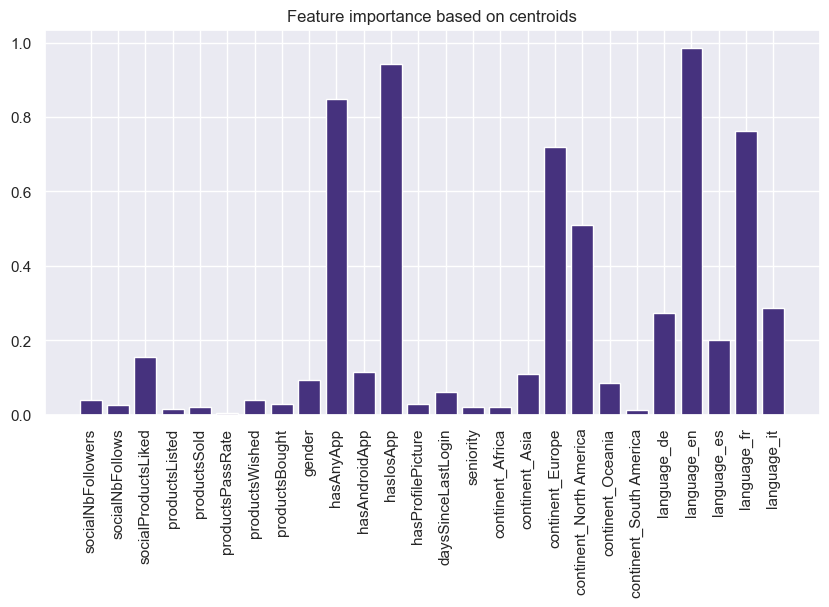

,0,1,2,3,4,5
hasAnyApp,-0.686446,-0.855132,1.000000,-0.726837,1.000000,-0.898278
hasIosApp,-1.000000,-1.000000,0.991702,-1.000000,1.000000,-1.000000
continent_Europe,0.955497,1.000000,0.190273,0.829186,0.934216,-1.000000
continent_North America,-1.000000,-1.000000,-0.585110,-0.940881,-0.973005,0.410333
language_de,-0.287667,-1.000000,-1.000000,-1.000000,-0.602411,-0.962801
language_en,-1.000000,1.000000,0.992624,-1.000000,-1.000000,0.918485
language_fr,-1.000000,-1.000000,-1.000000,1.000000,-0.008256,-1.000000
language_it,-0.269343,-1.000000,-1.000000,-1.000000,-0.578823,-0.994948


In [ ]:
feature_importance =\
    plot_feature_importance(df, clusters, centroids=kmeans.cluster_centers_)
analyze_features(df, feature_importance, clusters, NUM_CLUSTERS)

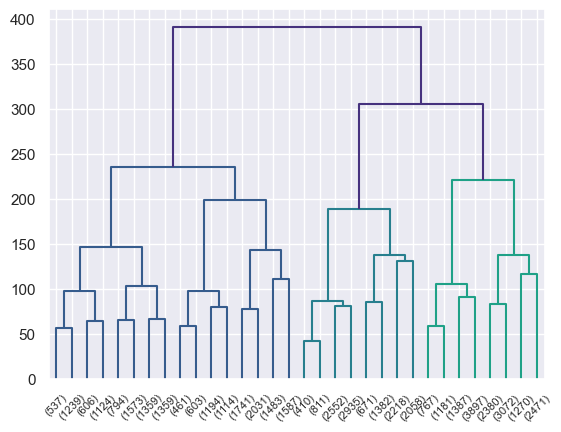

In [ ]:
X = df.values
linkage_matrix = sch.linkage(X, method='ward')

dendrogram = sch.dendrogram(linkage_matrix, truncate_mode='level', p=4)

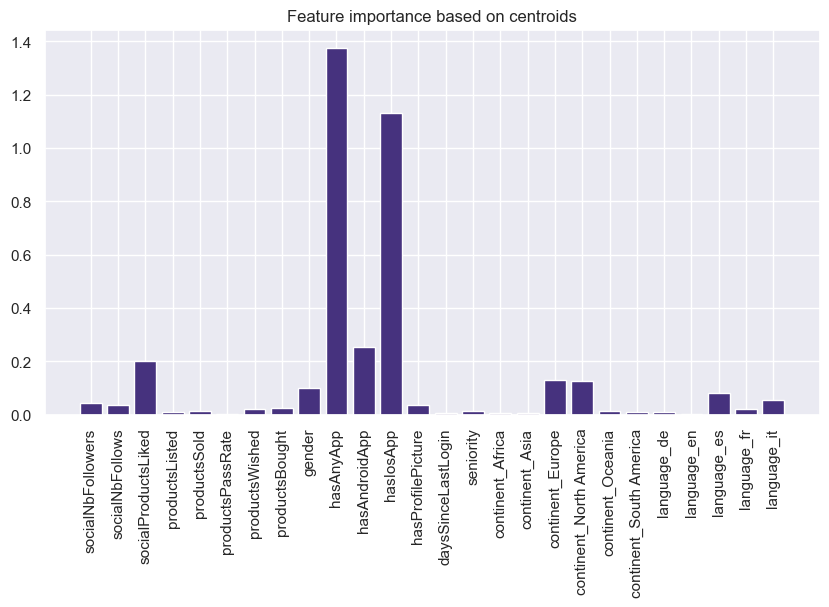

,0,1
hasAnyApp,0.999787,-0.945964
hasAndroidApp,-0.639245,-0.999661
hasIosApp,0.651582,-0.946032


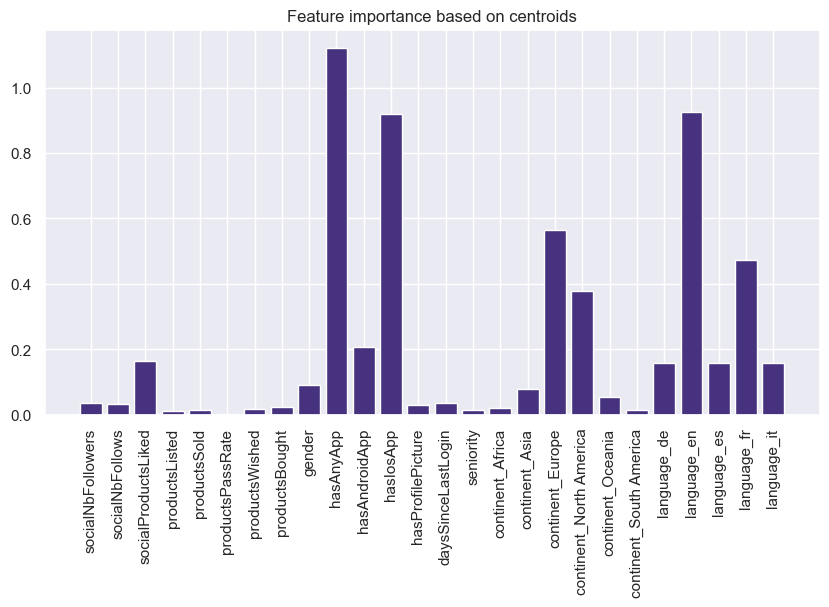

,0,1,2
hasAnyApp,0.999787,-0.897062,-0.984779
hasIosApp,0.651582,-0.897062,-0.984901
continent_Europe,0.557352,0.998926,-0.120731
continent_North America,-0.763680,-0.999540,-0.257352
language_en,0.026855,-0.999847,0.844992
language_fr,-0.471843,0.028918,-0.918174


In [ ]:
for cut_height in [350, 250]:
    clusters = sch.fcluster(linkage_matrix, cut_height, criterion='distance')
    plot_3d(X_pca, clusters, f'Cut height: {cut_height}')
    fi = plot_feature_importance(df, clusters-1)
    display(analyze_features(df, fi, clusters-1, clusters.max()))

2 3 4 5 6 7 8 9 10 11 

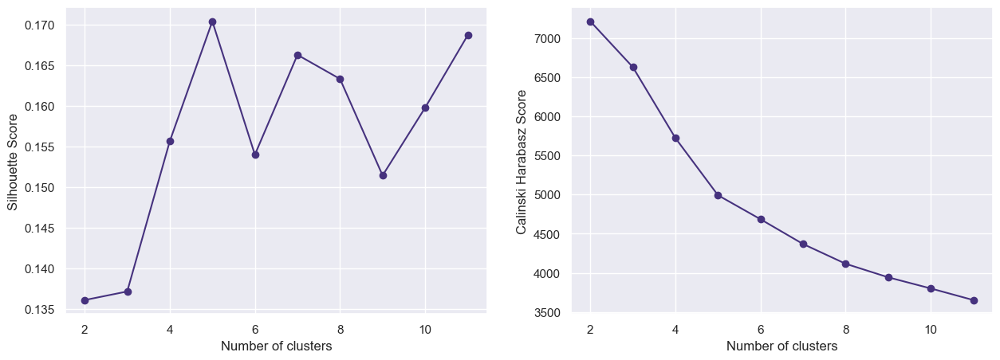

In [ ]:
from sklearn.cluster import Birch

silhouette = []


calinski = []


for k in range(2, 12):


    birch = Birch(n_clusters=k)


    birch_labels = birch.fit_predict(df)


    silhouette.append(metrics.silhouette_score(


        df, birch_labels, sample_size=5000))


    calinski.append(metrics.calinski_harabasz_score(df, birch_labels))


    print(k, end=' ')



plt.figure(figsize=(15, 5))


plt.subplot(1, 2, 1)


plt.plot(range(2, 12), silhouette, marker='o')


plt.xlabel('Number of clusters')


plt.ylabel('Silhouette Score')


plt.subplot(1, 2, 2)


plt.plot(range(2, 12), calinski, marker='o')


plt.xlabel('Number of clusters')


plt.ylabel('Calinski Harabasz Score')


plt.show()

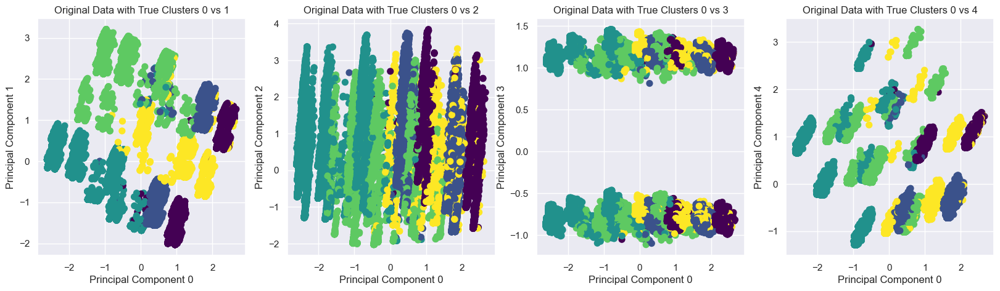

In [ ]:
birch = Birch(n_clusters=5)
birch_labels = birch.fit_predict(df)
plot_2d(X_pca, birch_labels)
plot_3d(X_pca, birch_labels)

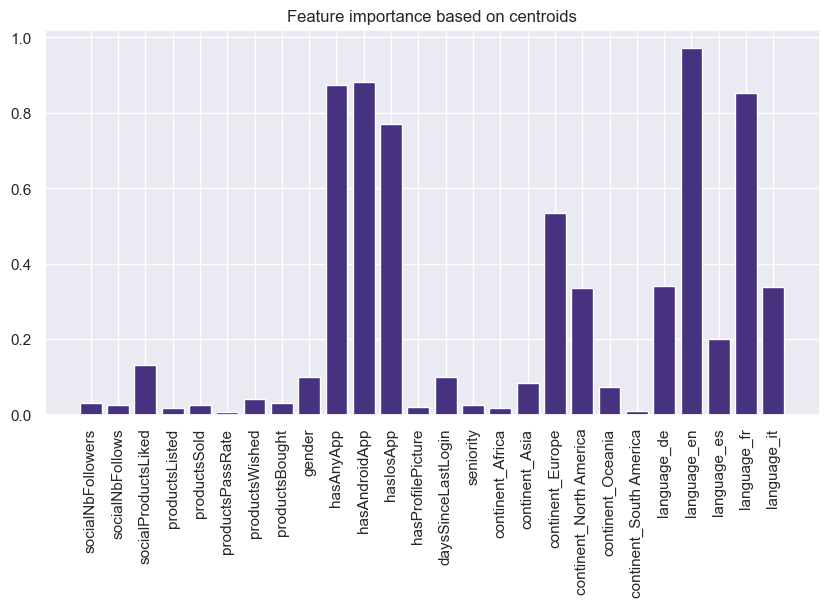

,0,1,2,3
hasAnyApp,-0.274514,-0.200382,-0.997607,1.000000
hasAndroidApp,-0.996792,-0.996179,-1.000000,-0.893046
hasIosApp,-0.275316,-0.200594,-0.997607,0.901456
continent_Europe,0.995187,0.993207,-0.087003,0.108571
continent_North America,-0.999799,-0.996391,-0.277525,-0.523019
language_de,-1.000000,-0.208448,-0.978219,-0.999784
language_en,-1.000000,-1.000000,0.816898,0.949542
language_fr,1.000000,-1.000000,-0.876257,-0.966792
language_it,-1.000000,-0.228614,-0.994256,-1.000000


In [ ]:
fi = plot_feature_importance(df, birch_labels)
analyze_features(df, fi, birch_labels, 4)

## Cuvanje info za top 5-7 drzava


In [57]:
df = df_with_country_codes.copy()
df.head()

,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,countryCode,continent_Africa,continent_Asia,continent_Europe,continent_North America,continent_Oceania,continent_South America,language_de,language_en,language_es,language_fr,language_it,civilityTitle_miss,civilityTitle_mr,civilityTitle_mrs
0,1,1,1,1,1,1,1,1,0,1,True,False,True,True,11,3196,106.53,8.88,gb,False,False,True,False,False,False,False,True,False,False,False,False,True,False
1,1,0,1,1,1,1,0,0,1,2,True,False,True,True,12,3204,106.80,8.90,mc,False,False,True,False,False,False,False,True,False,False,False,False,False,True
2,1,1,1,1,1,1,1,1,1,2,True,False,True,False,11,3203,106.77,8.90,fr,False,False,True,False,False,False,False,False,False,True,False,False,False,True
3,1,1,1,1,1,1,1,0,1,2,True,False,True,False,12,3198,106.60,8.88,us,False,False,False,True,False,False,False,True,False,False,False,False,False,True
4,1,0,0,1,1,1,0,0,1,2,False,False,False,True,22,2854,95.13,7.93,us,False,False,False,True,False,False,False,True,False,False,False,False,False,True


In [58]:
df.drop(['continent_Africa', 'continent_Asia', 'continent_Europe',
         'continent_North America', 'continent_Oceania', 'continent_South America'],
        axis=1, inplace=True)
df.drop(['civilityTitle_miss', 'civilityTitle_mr', 'civilityTitle_mrs', 'civilityGenderId',
         'seniorityAsMonths', 'seniorityAsYears'], axis=1, inplace=True)
df.head()

,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,countryCode,language_de,language_en,language_es,language_fr,language_it
0,1,1,1,1,1,1,1,1,0,True,False,True,True,11,3196,gb,False,True,False,False,False
1,1,0,1,1,1,1,0,0,1,True,False,True,True,12,3204,mc,False,True,False,False,False
2,1,1,1,1,1,1,1,1,1,True,False,True,False,11,3203,fr,False,False,False,True,False
3,1,1,1,1,1,1,1,0,1,True,False,True,False,12,3198,us,False,True,False,False,False
4,1,0,0,1,1,1,0,0,1,False,False,False,True,22,2854,us,False,True,False,False,False


In [59]:
df['countryCode'].value_counts()[df['countryCode'].value_counts() > 1000]

countryCode
fr    11145
us     7459
gb     5454
it     4628
de     3836
es     2720
au     1527
dk     1278
se     1193
be     1047
Name: count, dtype: int64

In [60]:
df['countryCode'] = df['countryCode'].apply(
    lambda x: x if x in ['us', 'gb', 'fr', 'de', 'it', 'es', 'au'] else np.nan)

In [61]:
df = pd.get_dummies(df, columns=['countryCode'])
df.head()

,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,language_de,language_en,language_es,language_fr,language_it,countryCode_au,countryCode_de,countryCode_es,countryCode_fr,countryCode_gb,countryCode_it,countryCode_us
0,1,1,1,1,1,1,1,1,0,True,False,True,True,11,3196,False,True,False,False,False,False,False,False,False,True,False,False
1,1,0,1,1,1,1,0,0,1,True,False,True,True,12,3204,False,True,False,False,False,False,False,False,False,False,False,False
2,1,1,1,1,1,1,1,1,1,True,False,True,False,11,3203,False,False,False,True,False,False,False,False,True,False,False,False
3,1,1,1,1,1,1,1,0,1,True,False,True,False,12,3198,False,True,False,False,False,False,False,False,False,False,False,True
4,1,0,0,1,1,1,0,0,1,False,False,False,True,22,2854,False,True,False,False,False,False,False,False,False,False,False,True


<Axes: >

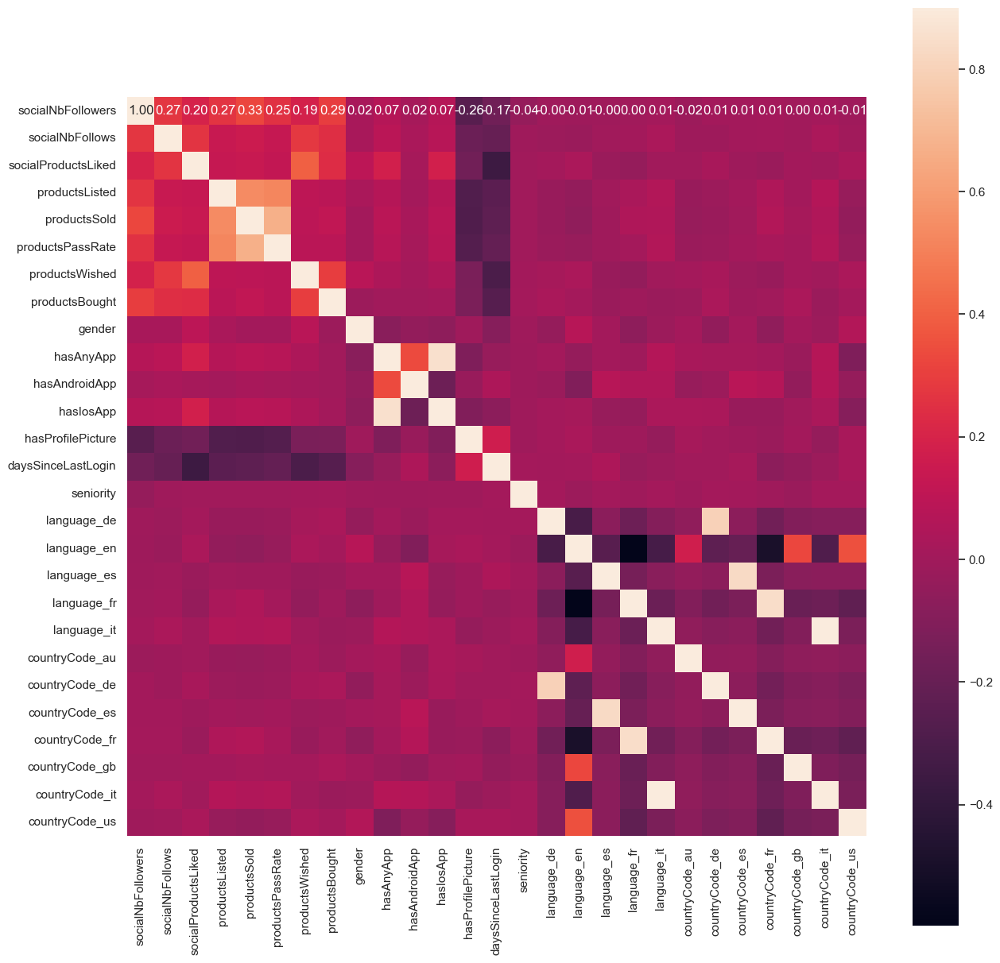

In [62]:
corr_matrix = df.corr()
plt.figure(figsize=(15, 15))
sns.heatmap(corr_matrix,  vmax=.9, square=True,
            annot=True, fmt='.2f')

In [63]:
scaler = MinMaxScaler((-1, 1))
df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)

df.describe()

,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,language_de,language_en,language_es,language_fr,language_it,countryCode_au,countryCode_de,countryCode_es,countryCode_fr,countryCode_gb,countryCode_it,countryCode_us
count,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000
mean,-0.569895,-0.846302,-0.391238,-0.930707,-0.918167,-0.962460,-0.637982,-0.785691,0.494695,-0.165555,-0.848834,-0.309807,0.924156,0.306102,0.193923,-0.828859,0.020740,-0.881551,-0.489952,-0.820378,-0.938625,-0.845820,-0.890675,-0.552050,-0.780788,-0.813987,-0.700201
std,0.821725,0.532708,0.920299,0.365768,0.396197,0.271427,0.770059,0.618625,0.869076,0.986211,0.528664,0.950809,0.382019,0.698404,0.954915,0.559464,0.999795,0.472093,0.871758,0.571828,0.344942,0.533474,0.454645,0.833819,0.624803,0.580889,0.713953
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,-0.260745,-0.971671,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
50%,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,1.000000,0.624642,0.949008,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
75%,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,1.000000,-1.000000,1.000000,1.000000,0.942693,0.977337,-1.000000,1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


2 3 4 5 6 7 8 9 10 11 

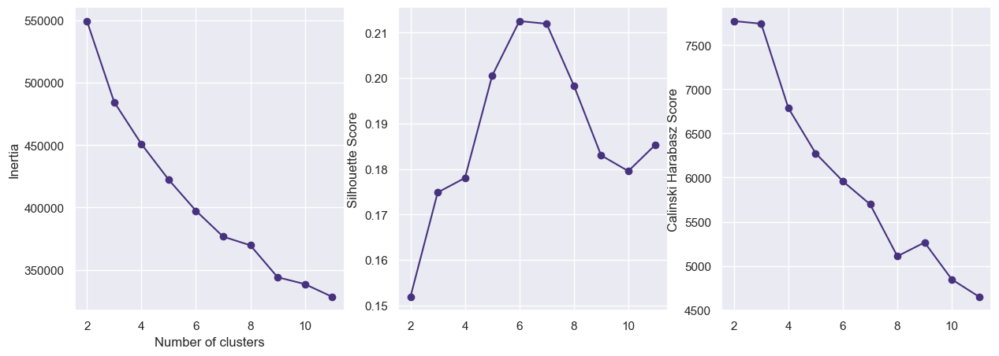

In [64]:
k_range = range(2, 12)
inertia = []
silhouette = []
calinski = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df)
    inertia.append(kmeans.inertia_)
    silhouette.append(metrics.silhouette_score(
        df, kmeans.labels_, sample_size=10000))
    calinski.append(metrics.calinski_harabasz_score(df, kmeans.labels_))
    print(k, end=' ')

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(k_range, inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.subplot(1, 3, 2)
plt.plot(k_range, silhouette, marker='o')
plt.ylabel('Silhouette Score')
plt.subplot(1, 3, 3)
plt.plot(k_range, calinski, marker='o')
plt.ylabel('Calinski Harabasz Score')
plt.show()

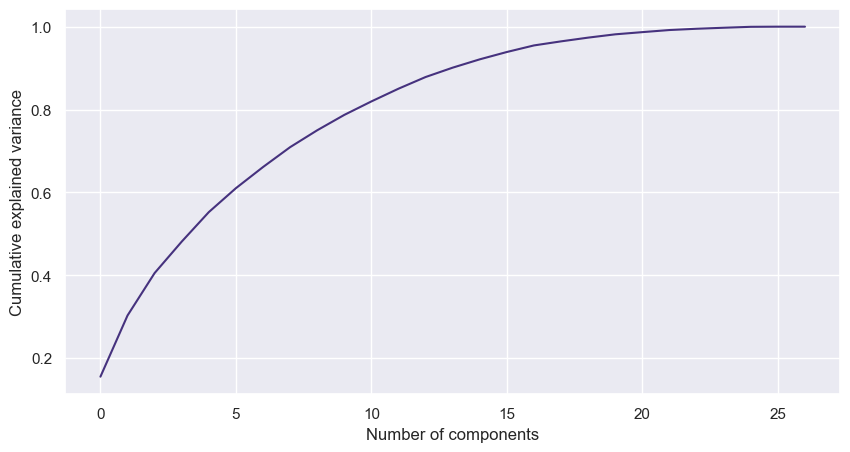

In [65]:
# apply pca
from sklearn.decomposition import PCA
pca = PCA()
pca.fit(df)
data_pca = pca.transform(df)

# plot pca
plt.figure(figsize=(10, 5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.show()

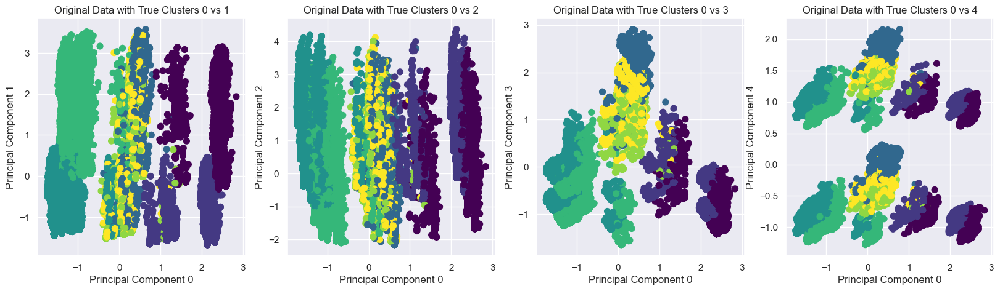

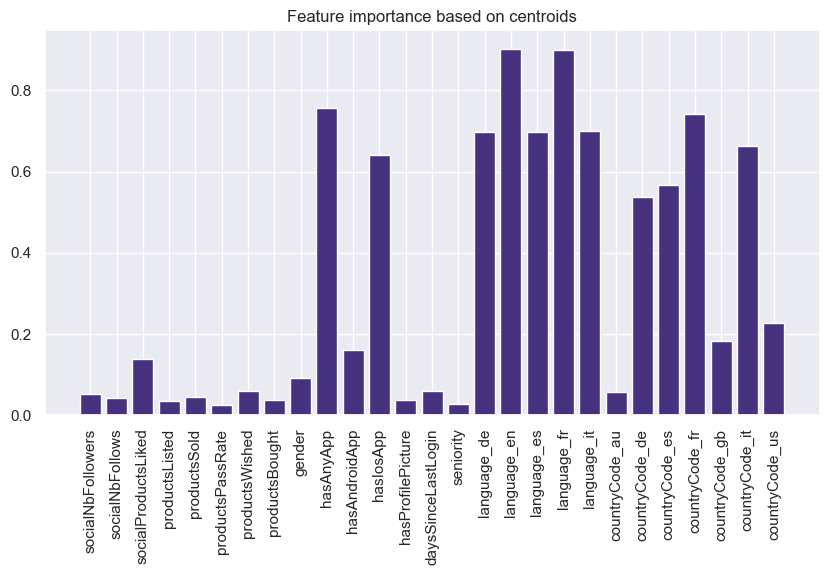

,0,1,2,3,4,5,6
hasAnyApp,1.000000,-1.000000,0.046133,-0.984301,1.000000,-0.137108,-0.144601
hasIosApp,0.523265,-1.000000,-0.190412,-1.000000,0.802121,-0.452251,-0.259155
language_de,-0.998856,-0.998932,-1.000000,-1.000000,-1.000000,-1.000000,0.995775
language_en,-1.000000,-1.000000,-1.000000,0.999481,0.997799,-1.000000,-1.000000
language_es,-0.996949,-0.999199,-1.000000,-1.000000,-0.998199,0.995907,-0.999531
language_fr,0.993516,0.992257,-1.000000,-1.000000,-1.000000,-0.999318,-1.000000
language_it,-0.997712,-0.994126,1.000000,-0.999481,-0.999600,-0.996589,-0.996244
countryCode_de,-0.995042,-0.990655,-0.991407,-0.970937,-0.956983,-0.984993,0.553052
countryCode_es,-0.995042,-0.987719,-0.998191,-0.982225,-0.976991,0.633015,-0.994836
countryCode_fr,0.724256,0.603791,-0.999095,-0.954590,-0.957383,-0.977490,-0.991080


In [66]:
pca = PCA(n_components=5)
X_pca = pca.fit_transform(df)

# Apply KMeans clustering
NUM_CLUSTERS = 7
kmeans = KMeans(n_clusters=NUM_CLUSTERS, random_state=42)
clusters = kmeans.fit_predict(df)

plot_2d(X_pca, clusters)
plot_3d(X_pca, clusters)
feature_importance =\
    plot_feature_importance(df, clusters, centroids=kmeans.cluster_centers_)
analyze_features(df, feature_importance, clusters, NUM_CLUSTERS)

-   0 i 1 - govore francuski (uglavnom su iz fr)
    -   0 - imaju app
    -   1 - nemaju app
-   2 - govore italijanski (uglavnom iz it)
-   3 i 4 - govore engleski (au, gb, us)
    -   3 - nemaju app
    -   4 - imaju app
-   5 - govore spanski (uglavnom iz es)
-   6 - govore nemacki (uglavnom iz de)


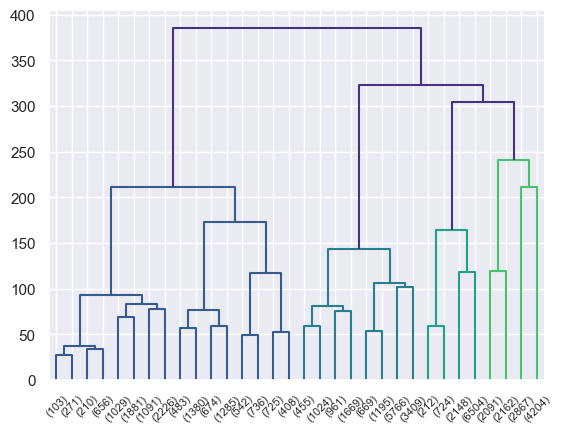

In [67]:
X = df.values
linkage_matrix = sch.linkage(X, method='ward')

dendrogram = sch.dendrogram(linkage_matrix, truncate_mode='level', p=4)

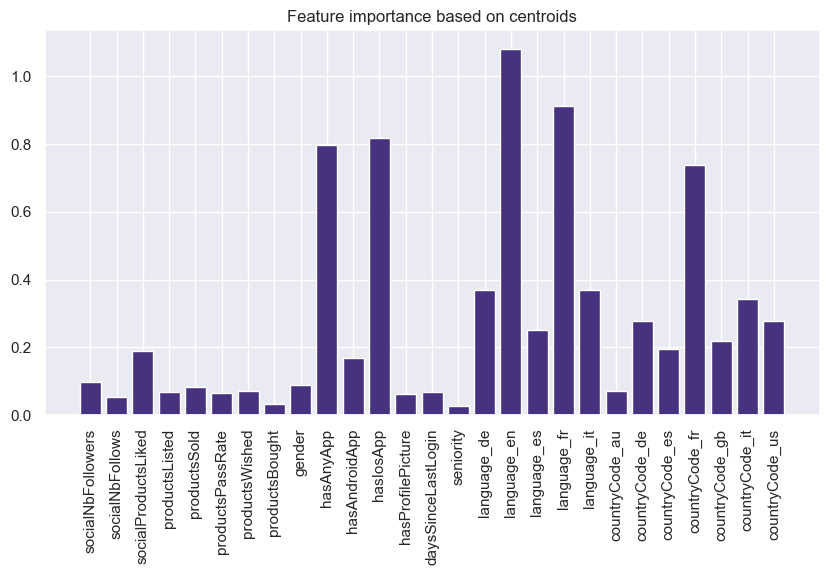

,0,1,2,3
hasAnyApp,-0.090365,-0.999868,0.952858,-0.087425
hasIosApp,-0.429489,-1.000000,0.939091,-0.299188
language_de,-1.000000,-1.000000,-0.987484,-0.258566
language_en,-0.834599,0.999868,0.901544,-1.000000
language_es,-0.999708,-0.999868,-0.984981,-0.492759
language_fr,0.833723,-1.000000,-0.973091,-1.000000
language_it,-0.999416,-1.000000,-0.955987,-0.248675
countryCode_de,-0.990657,-0.970953,-0.948060,-0.416637
countryCode_fr,0.519854,-0.954449,-0.938256,-0.983575
countryCode_it,-0.988321,-0.981252,-0.928869,-0.282056


In [68]:
clusters = sch.fcluster(linkage_matrix, 250, criterion='distance')
plot_3d(X_pca, clusters, f'Cut height: 250')
fi = plot_feature_importance(df, clusters-1)
analyze_features(df, fi, clusters-1, clusters.max())